# version 1

In [ ]:
# import relevant modules
import cv2
import numpy as np
from matplotlib import pyplot as plt
import os
import random

# Define constants and helpers
IMG_DIR = "../data/train/jh"
png_files = [f for f in os.listdir(IMG_DIR) if f.lower().endswith('.png')]

def imshow(img, title, subplot=None):
    if subplot:
        plt.subplot(subplot)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB)), plt.title(title)

def imshow_bulk(img, title, plot):
    plot.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB)), plot.set_title(title)

In [3]:
from playground.helper_functions.preprocessing import replace_black_with_median

"""
Now try tokenisation methods. First, prep some binarised images
"""
NUM_IMGS = 50
filepaths = random.choices(png_files, k=NUM_IMGS)
imgs = [cv2.imread(os.path.join(IMG_DIR, filepath)) for filepath in filepaths]
denoised_imgs = [replace_black_with_median(img.copy()) for img in imgs]

# Apply thresholding to binarize the image
gray_denoised_imgs = [cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) for img in denoised_imgs]
def advanced_binarization(img):
    """
    To prevent missing out on text characters which are too bright or light-colored, compare
    grayscale, HSV Value (V) channel, and LAB Lightness (L) channel to pick the best channel
    for binarization.
    """
    # Get grayscale, HSV V, and LAB L channels
    grayscale = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    v_channel = hsv[:, :, 2]
    lab = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
    l_channel = lab[:, :, 0]

    # Pick the best channel dynamically (whichever has the highest variance)
    choices = [grayscale, v_channel, l_channel]
    best_channel = max(choices, key=lambda x: np.var(x))  # Higher variance = better contrast

    # Apply Adaptive Thresholding for dynamic text binarization
    binarized = cv2.adaptiveThreshold(
        best_channel, 255, 
        cv2.ADAPTIVE_THRESH_GAUSSIAN_C, 
        cv2.THRESH_BINARY_INV, 
        11, 2
    )
    return binarized
binarised_imgs = [advanced_binarization(img) for img in denoised_imgs]

fig, axes = plt.subplots(nrows=NUM_IMGS, ncols=3, figsize=(12, NUM_IMGS))
for i in range(NUM_IMGS):
    imshow_bulk(imgs[i], f"original img {i}", axes[i,0])
    imshow_bulk(denoised_imgs[i], f"denoised {i}", axes[i,1])
    imshow_bulk(binarised_imgs[i], f"binarised {i}", axes[i,2])
plt.tight_layout()
plt.show()



ModuleNotFoundError: No module named 'playground'

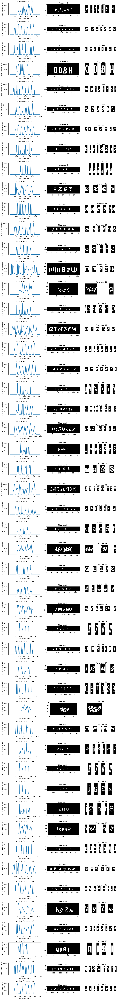

In [ ]:
"""
Now try tokenising the binarised images using the various methods below
"""

"""
Connected Component Analysis (CCA)
"""
# # Find connected components
# contours, _ = cv2.findContours(binary, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# char_images = []
# for cnt in contours:
#     x, y, w, h = cv2.boundingRect(cnt)
#     char_images.append(binary[y:y+h, x:x+w])  # Crop character

# # Sort by x-coordinates to maintain reading order
# char_images = sorted(char_images, key=lambda im: im.shape[1])

# # Display segmented characters
# for i, char in enumerate(char_images):
#     plt.subplot(21, len(char_images), i+2)
#     plt.imshow(char, cmap='gray')
#     plt.axis('off')

"""
Vertical Projection (to get the horizontal segments of characters)
"""
# Compute vertical projection (sum of pixel values along columns)
vertical_projs = [np.sum(binary, axis=0) for binary in binarised_imgs]

# Identify gap points (valleys where projection value is low), then derive horizontal segments of characters
thresholds = [np.max(vertical_proj) * 0.05 for vertical_proj in vertical_projs] # Adjust threshold as needed
all_x_gap_points = [np.where(vertical_proj < threshold)[0] for vertical_proj, threshold in zip(vertical_projs, thresholds)]
all_x_segments = []
for x_gap_points in all_x_gap_points:
    x_segments = []
    prev = 0
    for point in x_gap_points:
        if point - prev > 2:  # Adjust spacing threshold
            x_segments.append((prev, point))
        prev = point
    all_x_segments.append(x_segments)

# Compute horizontal projection (sum of pixel values along rows) to trim the vertical axis
horizontal_projs = [np.sum(binary, axis=1) for binary in binarised_imgs]
# Find min_y and max_y for each image
all_y_bounds = []
for horizontal_proj in horizontal_projs:
    nonzero_indices = np.where(horizontal_proj > 0)[0]  # Find rows containing characters
    if nonzero_indices.size > 0:
        min_y, max_y = max(0,nonzero_indices[0]-10), nonzero_indices[-1]+10
    else:
        min_y, max_y = 0, horizontal_proj.shape[0] - 1  # If the image is empty, keep full height
    all_y_bounds.append((min_y, max_y))


# Extract individual characters using bounding boxes
all_char_images = []
i = 0
for x_segments, binary, y_bounds in zip(all_x_segments, binarised_imgs, all_y_bounds):
    char_images = []
    for start,end in x_segments:
        char_images.append(binary[y_bounds[0]:y_bounds[1]+1, start:end+1])
    # Remove any noise (> 95% zeros)
    char_images = [char for char in char_images if not np.count_nonzero(char == 0) / char.size > 0.95]
    # # Segment any char images which are too wide compared to the median width
    # median_width = np.median([char.shape[1] for char in char_images])
    # for char in char_images:
    #     if char.shape[1] > median_width * 2:
    #         mid = char.shape[1] // 2
    #         char_images.append(char[:, :mid])
    #         char_images.append(char[:, mid:])
    #         char_images.remove(char)

    all_char_images.append(char_images)
    i += 1



# Create a figure
fig, axes = plt.subplots(NUM_IMGS, 3, figsize=(12, 2 * NUM_IMGS))

# Loop over each image
for i in range(NUM_IMGS):
    # Plot vertical projection in the first column
    ax1 = axes[i, 0]  # First column
    ax1.plot(vertical_projs[i])  # Plot the vertical projection
    ax1.set_title(f"Vertical Projection {i + 1}")
    ax1.set_xlabel("X (Column Index)")
    ax1.set_ylabel("Sum of pixel values")

    # Plot binarised image in the second column
    ax2 = axes[i, 1]  # Second column
    imshow_bulk(binarised_imgs[i], f"Binarised {i + 1}", ax2)

    # Plot tokenized characters in the third column
    ax3 = axes[i, 2]  # Third column
    tokenized_imgs = all_char_images[i]
    
    # Create a list to hold the images with spacing
    tokenized_with_spacing = []
    for char_img in tokenized_imgs:
        tokenized_with_spacing.append(char_img)  # Add the character image
        # Add a white image for spacing
        blank_image = np.ones_like(char_img) * 255
        tokenized_with_spacing.append(blank_image)
    
    # Combine tokenized characters with spacing
    if tokenized_with_spacing:
        combined_img = np.hstack(tokenized_with_spacing)
        
        ax3.imshow(cv2.cvtColor(combined_img, cv2.COLOR_BGR2RGB))
        ax3.set_title(f"Tokenized {i + 1}")
        ax3.axis('off')  # Turn off axes for a cleaner display

plt.tight_layout()
plt.show()

In [ ]:
"""
Improvement to vertical projection: Try normalising the vertical projection graph, and segment based on peak-trough instead of using a fixed threshold
"""
"""
Vertical Projection
"""

# from scipy.signal import find_peaks

# def find_segmentation_points(projection, min_dist=30, max_dist=50):
#     """
#     Find segmentation points (troughs) in the vertical projection.

#     Rules:
#     - A trough must be at least `min_dist` away from the last peak.
#     - If a trough isn't found within `max_dist` from the last one, force the next trough.

#     Args:
#     - projection: 1D numpy array of vertical projection values.
#     - min_dist: Minimum distance required between a peak and a trough.
#     - max_dist: Maximum distance before forcing a trough.

#     Returns:
#     - seg_points: List of x-coordinates for character segmentation.
#     """
#     # Normalize projection for consistency
#     projection = projection / np.max(projection)

#     # Find peaks (characters) and troughs (spaces between characters)
#     peaks, _ = find_peaks(projection, distance=min_dist)
#     troughs, _ = find_peaks(-projection, distance=min_dist)

#     # Apply rules
#     filtered_troughs = []
#     last_peak = None
#     last_trough = None

#     for trough in troughs:
#         # Rule 1: Ensure minimum distance from last peak
#         if last_peak is not None and (trough - last_peak) < min_dist:
#             continue  # Skip this trough
        
#         # Rule 2: Ensure we don’t go too far without a trough
#         if last_trough is not None and (trough - last_trough) > max_dist:
#             filtered_troughs.append(trough)  # Force segmentation at the first available trough
        
#         # Store the last confirmed peak and trough
#         filtered_troughs.append(trough)
#         last_trough = trough

#         # Find the nearest peak before this trough
#         possible_peaks = peaks[peaks < trough]
#         if len(possible_peaks) > 0:
#             last_peak = possible_peaks[-1]  # Last peak before this trough

#     return filtered_troughs

# # Compute vertical projection (sum of pixel values along columns)
# vertical_projs = [np.sum(binary, axis=0) for binary in binarised_imgs]

# # Plot settings
# fig, axes = plt.subplots(NUM_IMGS, 1, figsize=(8, NUM_IMGS * 3))

# for i in range(NUM_IMGS):
#     vertical_proj = vertical_projs[i]
#     seg_points = find_segmentation_points(vertical_proj, min_dist=5, max_dist=30)

#     # Plot vertical projection
#     axes[i].plot(vertical_proj, color='blue', label=f"Image {i+1} Projection")
#     axes[i].scatter(seg_points, vertical_proj[seg_points], color='red', marker='x', label="Segmentation Points")
#     axes[i].legend()
#     axes[i].set_ylabel("Intensity")
#     axes[i].set_xlabel("X (Column Index)")


# plt.suptitle("Vertical Projection Segmentation Across 10 Images", fontsize=14)
# plt.tight_layout()
# plt.show()




'\nVertical Projection\n'

# VERSION 2

1. **Noise Removal:**
   - **Function:** `replace_black_with_median()`
     - Replaces black pixels (background noise) with the median value using a median filter.
   - **NEW → Function:** `remove_salt_and_pepper_noise()`
     - Removes salt-and-pepper noise using morphological opening.

2. **Blurring:**
   - **Function:** `cv2.GaussianBlur()`
     - Applies Gaussian blur to reduce noise and smooth the image.

3. **Thresholding:**
   - **Function:** `cv2.adaptiveThreshold()`
     - Applies adaptive thresholding (Gaussian) to binarize the image, making characters more distinct from the background.

4. **Character Segmentation:**
   - **Function:** `segment_captcha_with_projection()`
     - Uses vertical projection to find column sums and identifies regions (character boundaries) based on a threshold to segment the captcha into individual characters.

5. **NEW!→ Character Boundary Merging (if too many segments):**
   - **Function:** `merge_segments_if_needed()`
     - Merges adjacent segments if there are more than expected, based on a distance threshold.

6. **NEW!→ Character Splitting (if too few segments):**
   - **Function:** `split_segments_if_needed()`
     - Splits large segments if there are fewer than expected, based on a width threshold.

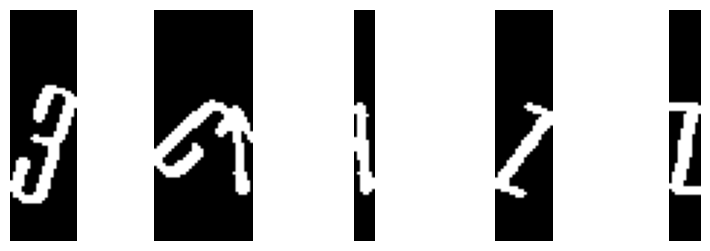

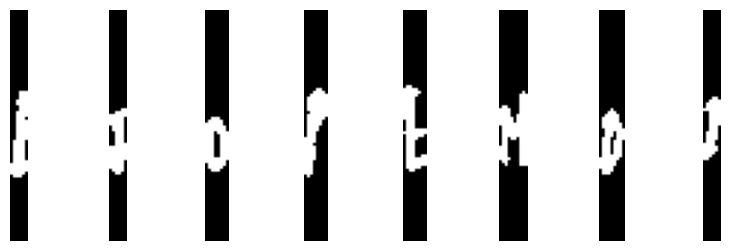

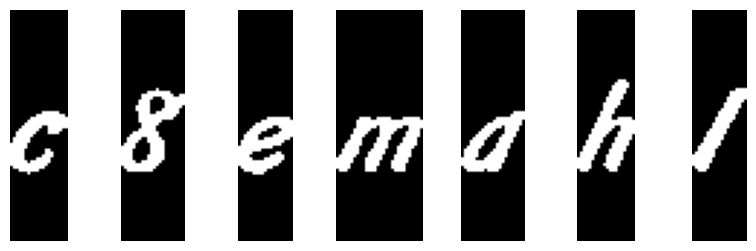

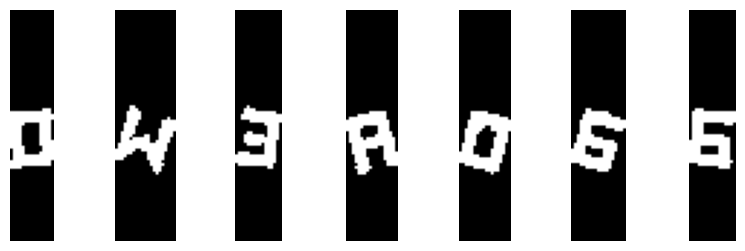

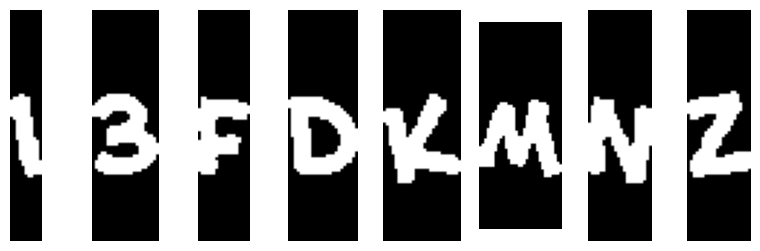

...

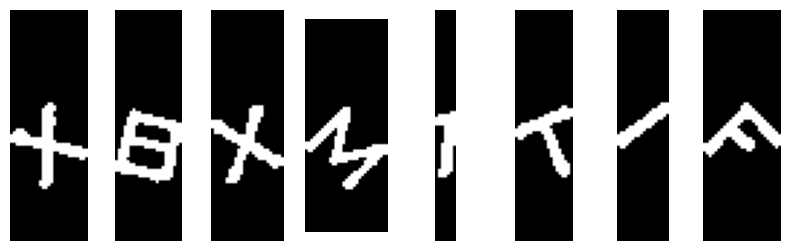

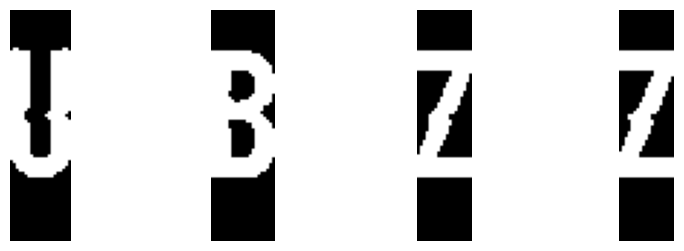

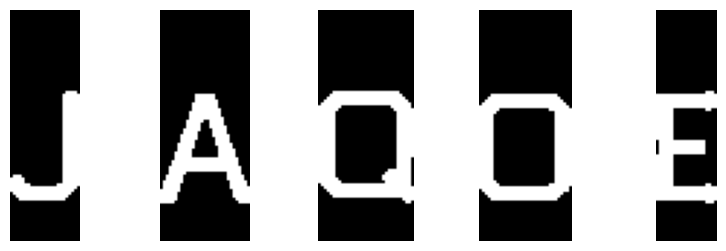

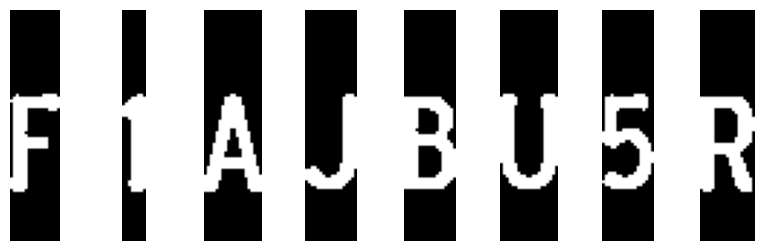

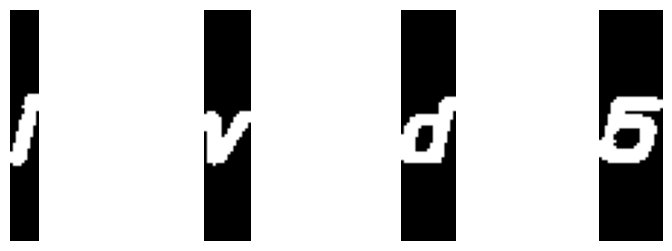

Number of captchas where segments match filename characters: 477/500


In [2]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os
import random

# Tunable parameters
TUNABLE_PARAMETERS = {
    "median_filter_kernel_size": 7,        # Kernel size for median filter
    "gaussian_blur_kernel_size": (3, 3),   # Kernel size for Gaussian blur (width, height)
    "salt_pepper_kernel_size": 1,          # Kernel size for morphological opening to remove salt & pepper noise
    "adaptive_threshold_block_size": 31,   # Block size for adaptive thresholding (odd integer)
    "adaptive_threshold_C": 2,             # Constant C for adaptive thresholding
    "projection_threshold": 0.1,           # Threshold value for vertical projection to detect characters
    "merge_distance_threshold": 10,        # Threshold for merging segments (in pixels)
    "split_width_threshold": 1.5          # Threshold for splitting large segments based on width (relative size)
}

FOLDER_PATH = "../data/train/combine"
NUM_SAMPLES = 500

# Replace all black lines with median pixel
def replace_black_with_median(image, kernel_size=TUNABLE_PARAMETERS['median_filter_kernel_size']):
    is_color = len(image.shape) == 3
    if is_color:
        black_pixels = np.all(image == [0, 0, 0], axis=-1)
    else:
        black_pixels = (image == 0)
    
    median_filtered = cv2.medianBlur(image, kernel_size)
    
    image[black_pixels] = median_filtered[black_pixels]
    return image

def plot_image(img, title=None, cmap=None):
    """Helper function to plot images"""
    plt.figure(figsize=(8, 6))
    plt.imshow(img, cmap=cmap)
    if title:
        plt.title(title)
    plt.axis('off')
    plt.show()

def segment_captcha_with_projection(image, projection_threshold=TUNABLE_PARAMETERS['projection_threshold']):
    vertical_projection = np.sum(image, axis=0)
    max_projection = vertical_projection.max()
    if max_projection != 0:
        vertical_projection = vertical_projection / max_projection

    projection_binary = vertical_projection > projection_threshold

    character_boundaries = []
    start_idx = None
    for i in range(1, len(projection_binary)):
        if projection_binary[i] != projection_binary[i - 1]:
            if projection_binary[i] == 1:
                start_idx = i
            elif projection_binary[i] == 0 and start_idx is not None:
                end_idx = i
                character_boundaries.append((start_idx, end_idx))
                start_idx = None
    
    # Instead of returning the images, return the boundaries (start, end) of each character
    return character_boundaries, vertical_projection, projection_binary

def remove_salt_and_pepper_noise(image, kernel_size=TUNABLE_PARAMETERS['salt_pepper_kernel_size']):
    kernel = np.ones((kernel_size, kernel_size), np.uint8)
    return cv2.morphologyEx(image, cv2.MORPH_OPEN, kernel)

def merge_segments_if_needed(character_boundaries, max_segments, merge_distance_threshold=TUNABLE_PARAMETERS['merge_distance_threshold'], max_merge_attempts=5):
    """
    Merges adjacent segments if there are more segments than the expected number.
    """
    attempts = 0
    while len(character_boundaries) > max_segments and attempts < max_merge_attempts:
        min_distance = float('inf')
        min_pair = None
        for i in range(len(character_boundaries) - 1):
            start_i, end_i = character_boundaries[i]
            start_j, end_j = character_boundaries[i + 1]
            distance = start_j - end_i
            if distance < min_distance:
                min_distance = distance
                min_pair = (i, i + 1)

        if min_distance < merge_distance_threshold:
            i, j = min_pair
            # Merge characters[i] and characters[j]
            character_boundaries[i] = (character_boundaries[i][0], character_boundaries[j][1])  # Merge the end of i with the end of j
            character_boundaries.pop(j)  # Remove j after merging
            attempts = 0  # Reset attempts when merge happens
        else:
            attempts += 1  # Increment attempt counter when no merge happens

    return character_boundaries

def split_segments_if_needed(character_boundaries, expected_num_segments, split_width_threshold=TUNABLE_PARAMETERS['split_width_threshold'], max_split_attempts=5):
    """
    Splits segments if there are fewer segments than expected.
    Splits large segments based on their width.
    """
    attempts = 0
    while len(character_boundaries) < expected_num_segments and attempts < max_split_attempts:
        for i in range(len(character_boundaries)):
            start, end = character_boundaries[i]
            segment_width = end - start
            if segment_width > split_width_threshold * 28:  # If the width is larger than the threshold
                # Split the segment in half
                mid_point = (start + end) // 2
                character_boundaries[i] = (start, mid_point)
                character_boundaries.insert(i + 1, (mid_point, end))
                attempts = 0  # Reset attempts when a split happens
                break  # Split only one segment at a time
        else:
            attempts += 1  # Increment attempt counter if no split happens

    return character_boundaries


# Folder containing your images
folder_path = "../data/train/combine"  # Replace with the path to your folder

# Get all image filenames
all_images = [f for f in os.listdir(folder_path) if f.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.tiff'))]

# Randomly sample 20 images
sampled_images = random.sample(all_images, NUM_SAMPLES)

# Keep track of how many captchas match the number of characters
matching_count = 0
total_count = len(sampled_images)

# Loop through the 20 randomly selected images
for filename in sampled_images:
    image_path = os.path.join(folder_path, filename)
    filename_without_suffix = os.path.splitext(filename)[0]
    
    # Extract the characters from the filename, ignoring "-0" at the end
    correct_characters = filename_without_suffix.split('-')[0]

    # Read image
    image = cv2.imread(image_path)

    # Plot original image
    #plot_image(cv2.cvtColor(image, cv2.COLOR_BGR2RGB), f"Original Image: {filename_without_suffix}", cmap="viridis")

    # Apply black pixel replacement
    denoised = replace_black_with_median(image)

    # Convert to grayscale
    gray = cv2.cvtColor(denoised, cv2.COLOR_BGR2GRAY)

    # Display grayscale image after median filter
    #plot_image(gray, f"Image After Median Filter: {filename}", cmap='gray')

    # Remove salt and pepper noise before Gaussian blur
    denoised_after_noise_removal = remove_salt_and_pepper_noise(gray)

    # Display image after salt and pepper noise removal
    #plot_image(denoised_after_noise_removal, f"Image After Salt and Pepper Noise Removal: {filename}", cmap='gray')

    # Apply Gaussian blur after noise removal
    blurred = cv2.GaussianBlur(denoised_after_noise_removal, TUNABLE_PARAMETERS['gaussian_blur_kernel_size'], 0)

    # Display image after Gaussian blur
    #plot_image(blurred, f"Image After Gaussian Blur: {filename}", cmap='gray')

    # Apply adaptive thresholding
    thresh = cv2.adaptiveThreshold(
        blurred,
        255,
        cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
        cv2.THRESH_BINARY_INV,
        TUNABLE_PARAMETERS['adaptive_threshold_block_size'],
        TUNABLE_PARAMETERS['adaptive_threshold_C']
    )

    # Display image after noise removal
    #plot_image(thresh, f"Image After Noise Removal: {filename}", cmap='gray')

    # Use vertical projection for segmentation
    character_boundaries, vertical_projection, projection_binary = segment_captcha_with_projection(thresh)

    # Adjust the number of segments to match the filename characters
    character_boundaries = merge_segments_if_needed(character_boundaries, len(correct_characters))
    character_boundaries = split_segments_if_needed(character_boundaries, len(correct_characters))

    # Plot the vertical projection and its binary form
    # plt.figure(figsize=(10, 6))
    # plt.subplot(1, 2, 1)
    # plt.plot(vertical_projection)
    # plt.title("Vertical Projection")
    # plt.subplot(1, 2, 2)
    # plt.plot(projection_binary)
    # plt.title("Binary Projection (Thresholded)")
    # plt.show()

    # Display the segmented characters
    if len(character_boundaries) > 0:
        fig, axes = plt.subplots(1, len(character_boundaries), figsize=(10, 3))
        for i, (start, end) in enumerate(character_boundaries):
            char_image = thresh[:, start:end]
            axes[i].imshow(char_image, cmap='gray')
            axes[i].axis('off')
        plt.show()

        # Check if the number of segments now matches the number of characters in the filename
        if len(character_boundaries) == len(correct_characters):
            matching_count += 1
    else:
        print(f"No characters detected in {filename}.")

# Print the number of matching captchas
print(f"Number of captchas where segments match filename characters: {matching_count}/{total_count}")


## version 2 comparison with base w/o merge + split

In [4]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os
import random

# Replace all black lines with median pixel
def replace_black_with_median(image, kernel_size=5):
    """
    Replaces all black pixels in an image with the median of their local neighborhood.
    
    :param image: Input image (grayscale or color)
    :param kernel_size: Size of the patch used for computing the median
    :return: Image with black pixels replaced by median values
    """
    is_color = len(image.shape) == 3
    
    if is_color:
        black_pixels = np.all(image == [0, 0, 0], axis=-1)
    else:
        black_pixels = (image == 0)
    
    median_filtered = cv2.medianBlur(image, kernel_size)
    
    image[black_pixels] = median_filtered[black_pixels]
    return image

def plot_image(img, title=None, cmap=None):
    """Helper function to plot images"""
    plt.figure(figsize=(8, 6))
    plt.imshow(img, cmap=cmap)
    if title:
        plt.title(title)
    plt.axis('off')
    plt.show()

def segment_captcha_with_projection(image):
    """
    Segments a captcha image into individual characters using vertical projection.
    
    :param image: Input image (grayscale or binary)
    :return: List of segmented character images (28x28, with aspect ratio preserved)
    """
    # Create vertical projection profile (sum pixels along columns)
    vertical_projection = np.sum(image, axis=0)
    
    # Normalize projection to make it easier to threshold
    max_projection = vertical_projection.max()
    if max_projection != 0:
        vertical_projection = vertical_projection / max_projection

    # Use a threshold to detect character boundaries in the vertical projection
    projection_threshold = 0.1
    projection_binary = vertical_projection > projection_threshold

    # Find where projection changes (from 1 to 0 and vice versa)
    character_boundaries = []
    start_idx = None
    
    for i in range(1, len(projection_binary)):
        if projection_binary[i] != projection_binary[i - 1]:
            if projection_binary[i] == 1:
                start_idx = i  # Start of a new character
            elif projection_binary[i] == 0 and start_idx is not None:
                end_idx = i  # End of the current character
                character_boundaries.append((start_idx, end_idx))
                start_idx = None  # Reset start index for the next character
    
    # Segment characters based on the detected boundaries
    characters = []
    for (start, end) in character_boundaries:
        char_image = image[:, start:end]  # Slice out the character region
        
        # Resize horizontally to fit width (28px), while preserving the aspect ratio
        aspect_ratio = char_image.shape[0] / char_image.shape[1]  # Height to Width ratio
        new_height = int(28 * aspect_ratio)
        resized_char = cv2.resize(char_image, (28, new_height))  # Resize to width 28px
        
        # Now resize to 28x28 by padding the height if necessary
        if resized_char.shape[0] < 28:
            # Pad the image vertically (top-bottom) to make it 28px high
            top_pad = (28 - resized_char.shape[0]) // 2
            bottom_pad = 28 - resized_char.shape[0] - top_pad
            resized_char = cv2.copyMakeBorder(resized_char, top_pad, bottom_pad, 0, 0, cv2.BORDER_CONSTANT, value=255)

        characters.append(resized_char)
    
    return characters, vertical_projection, projection_binary

# Folder containing your images
folder_path = "../data/train/combine"  # Replace with the path to your folder

# Get all image files in the folder
all_files = [f for f in os.listdir(folder_path) if f.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.tiff'))]

# Take a random sample of 500 images
sample_files = random.sample(all_files, 500)

# Counter for correct segmentations
correct_segmentations = 0

# Loop through sampled files
for filename in sample_files:
    image_path = os.path.join(folder_path, filename)
    filename_without_suffix = os.path.splitext(filename)[0]
    
    # Extract number of characters from the file name (ignoring "-0")
    file_name_parts = filename_without_suffix.split('-')
    if len(file_name_parts) > 1 and file_name_parts[-1].isdigit():
        num_characters_in_filename = len(file_name_parts[0])
    else:
        num_characters_in_filename = len(file_name_parts[0])

    # Read image
    image = cv2.imread(image_path)

    # Apply black pixel replacement
    denoised = replace_black_with_median(image)

    # Convert to grayscale
    gray = cv2.cvtColor(denoised, cv2.COLOR_BGR2GRAY) 

    # Apply Gaussian blur to reduce noise
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)

    # Apply adaptive thresholding
    thresh = cv2.adaptiveThreshold(blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY_INV, 31, 2)

    # Use vertical projection for segmentation
    characters, vertical_projection, projection_binary = segment_captcha_with_projection(thresh)

    # Check if the number of segmented characters matches the number in the filename
    if len(characters) == num_characters_in_filename:
        correct_segmentations += 1

# Calculate the accuracy
accuracy = correct_segmentations / len(sample_files) * 100
print(f"Number of correct segmentations: {correct_segmentations} out of {len(sample_files)}")
print(f"Segmentation accuracy: {accuracy:.2f}%")


Number of correct segmentations: 408 out of 500
Segmentation accuracy: 81.60%


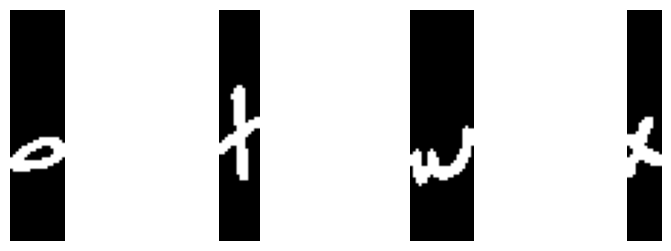

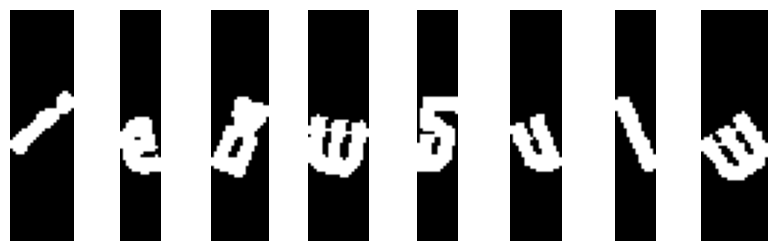

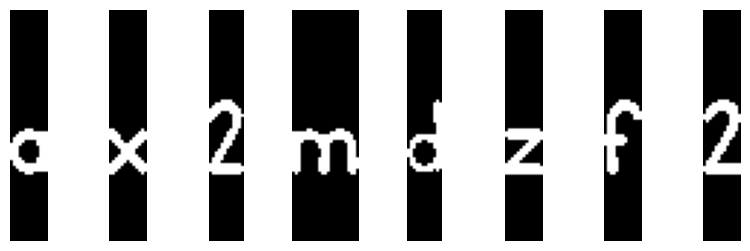

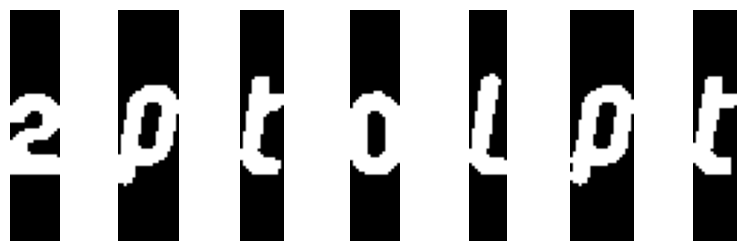

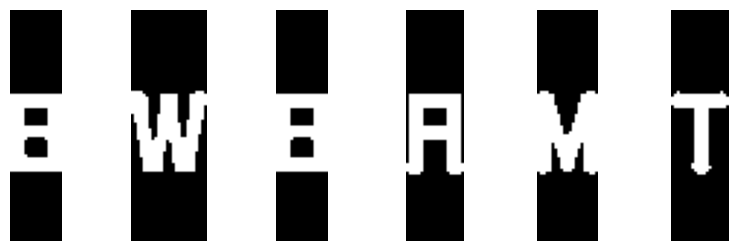

...

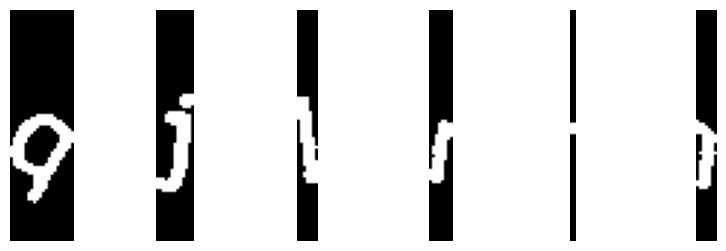

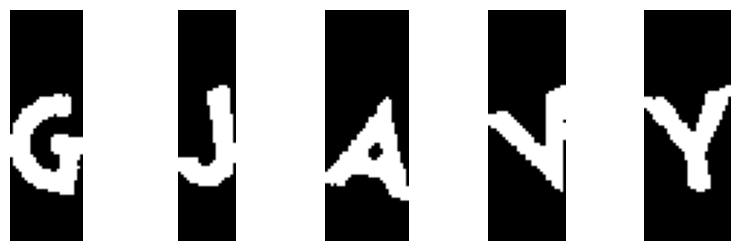

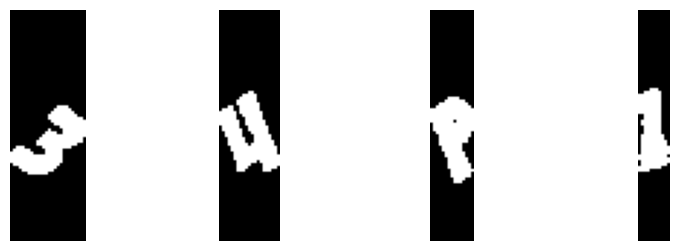

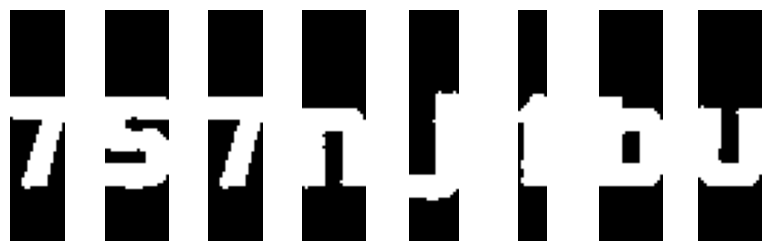

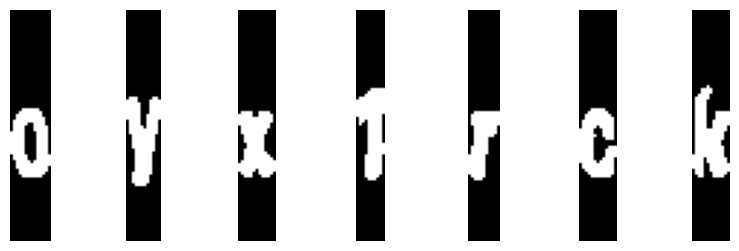

Number of captchas where segments match filename characters: 447/500


In [3]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os
import random

# Tunable parameters
TUNABLE_PARAMETERS = {
    "median_filter_kernel_size": 7,
    "gaussian_blur_kernel_size": (3, 3),
    "salt_pepper_kernel_size": 1,
    "adaptive_threshold_block_size": 31,
    "adaptive_threshold_C": 2,
    "projection_threshold": 0.1
}

FOLDER_PATH = "../data/train/combine"
NUM_SAMPLES = 500

# Replace all black lines with median pixel
def replace_black_with_median(image, kernel_size=TUNABLE_PARAMETERS['median_filter_kernel_size']):
    is_color = len(image.shape) == 3
    if is_color:
        black_pixels = np.all(image == [0, 0, 0], axis=-1)
    else:
        black_pixels = (image == 0)
    
    median_filtered = cv2.medianBlur(image, kernel_size)
    
    image[black_pixels] = median_filtered[black_pixels]
    return image

# Helper function to plot images
def plot_image(img, title=None, cmap=None):
    plt.figure(figsize=(8, 6))
    plt.imshow(img, cmap=cmap)
    if title:
        plt.title(title)
    plt.axis('off')
    plt.show()

# Segmentation using vertical projection
def segment_captcha_with_projection(image, projection_threshold=TUNABLE_PARAMETERS['projection_threshold']):
    vertical_projection = np.sum(image, axis=0)
    max_projection = vertical_projection.max()
    if max_projection != 0:
        vertical_projection = vertical_projection / max_projection

    projection_binary = vertical_projection > projection_threshold

    character_boundaries = []
    start_idx = None
    for i in range(1, len(projection_binary)):
        if projection_binary[i] != projection_binary[i - 1]:
            if projection_binary[i] == 1:
                start_idx = i
            elif projection_binary[i] == 0 and start_idx is not None:
                end_idx = i
                character_boundaries.append((start_idx, end_idx))
                start_idx = None
    
    return character_boundaries, vertical_projection, projection_binary

# Remove salt and pepper noise
def remove_salt_and_pepper_noise(image, kernel_size=TUNABLE_PARAMETERS['salt_pepper_kernel_size']):
    kernel = np.ones((kernel_size, kernel_size), np.uint8)
    return cv2.morphologyEx(image, cv2.MORPH_OPEN, kernel)

# Folder containing images
folder_path = "../data/train/combine"
all_images = [f for f in os.listdir(folder_path) if f.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.tiff'))]

sampled_images = random.sample(all_images, NUM_SAMPLES)
matching_count = 0
total_count = len(sampled_images)

# Process each image
for filename in sampled_images:
    image_path = os.path.join(folder_path, filename)
    filename_without_suffix = os.path.splitext(filename)[0]
    correct_characters = filename_without_suffix.split('-')[0]

    image = cv2.imread(image_path)
    denoised = replace_black_with_median(image)
    gray = cv2.cvtColor(denoised, cv2.COLOR_BGR2GRAY)
    denoised_after_noise_removal = remove_salt_and_pepper_noise(gray)
    blurred = cv2.GaussianBlur(denoised_after_noise_removal, TUNABLE_PARAMETERS['gaussian_blur_kernel_size'], 0)
    
    thresh = cv2.adaptiveThreshold(
        blurred,
        255,
        cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
        cv2.THRESH_BINARY_INV,
        TUNABLE_PARAMETERS['adaptive_threshold_block_size'],
        TUNABLE_PARAMETERS['adaptive_threshold_C']
    )

    character_boundaries, vertical_projection, projection_binary = segment_captcha_with_projection(thresh)
    
    if len(character_boundaries) > 0:
        fig, axes = plt.subplots(1, len(character_boundaries), figsize=(10, 3))
    
        # Ensure axes is always a list
        if len(character_boundaries) == 1:
            axes = [axes]  # Wrap single Axes object in a list
    
        for i, (start, end) in enumerate(character_boundaries):
            char_image = thresh[:, start:end]
            axes[i].imshow(char_image, cmap='gray')
            axes[i].axis('off')
    
        plt.show()


        if len(character_boundaries) == len(correct_characters):
            matching_count += 1
    else:
        print(f"No characters detected in {filename}.")

print(f"Number of captchas where segments match filename characters: {matching_count}/{total_count}")
